In [119]:
import os
import sys
import util
import pickle
import subprocess
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from geopy.distance import geodesic
from datetime import datetime
from rosely import WindRose
from tqdm import tqdm

is_windows = sys.platform.lower() not in ['darwin', 'linux']
proj_lib = subprocess.check_output(['where' if is_windows else 'which', 'python'])
proj_lib = proj_lib.decode('utf-8').split('\n')[0].split(os.path.sep)
if is_windows:
    proj_lib = os.path.join(proj_lib[0], os.path.sep, *proj_lib[1:-1], 'share', 'proj')
else:
    proj_lib = os.path.join(os.path.sep, *proj_lib[:-2], 'share', 'proj')
os.environ['PROJ_LIB'] = proj_lib

# from mpl_toolkits.basemap import Basemap
# conda install -c conda-forge basemap
# conda install -c conda-forge basemap-data-hires
# conda install -c conda-forge proj4
# conda install pyproj

In [120]:
# folders where the mass flow readings and wind data are imported
folders = ['apr2020', 'may2020', 'jun2020', 'jul2020', 'aug2020', 'sep2020', 'oct2020']
# folders where the location data is imported
location_data = ['location1.csv', 'location2.csv']
# each second
resampling = '1S'
# time frame, six months: 22 April 2020 to 22 October 2020
mask = lambda df: (df.index >= datetime(year=2020, month=4, day=22)) & (df.index < datetime(year=2020, month=10, day=23))


In [121]:
# Mass Flow Readings (Bunker)

In [122]:
# mflo1 = util.parse_raw(folders, ['mflo1'])
# mflo2 = util.parse_raw(folders, ['mflo2'])

# mflo1 = mflo1.loc[mask(mflo1)]
# mflo2 = mflo2.loc[mask(mflo2)]

# mflow = mflo1.join(mflo2, how='outer')

In [123]:
# import swifter
# from geopy.distance import geodesic
# import tqdm.notebook
# tqdm.notebook.tqdm_notebook.pandas()

# mflow['combined'] = mflow.T.progress_apply(np.mean).T
# mflow

In [124]:
# with open('unfiltered.pkl', 'wb') as f:
#     pickle.dump(mflow, f)

# mflo1.to_csv('mflo1.csv')
# mflo2.to_csv('mflo2.csv')

In [125]:
%%time

# parse main engine 1 reading
mflo1 = util.parse_raw(folders, ['mflo1'])
mflo1 = mflo1.loc[mask(mflo1)]
mflo1_unfiltered = mflo1
# filter noise
mflo1 = util.filter_signal(mflo1, window=3)
# resample (mean) to resampling frequency
mflo1 = mflo1.resample(resampling).mean()

100%|██████████| 27252/27252 [04:11<00:00, 108.22it/s]
files not parsed:
sep2020\v1_200905_184918.pkl
sep2020\v1_200905_235501.pkl
sep2020\v1_200919_183258.pkl
Wall time: 4min 33s


In [126]:
%%time

# parse main engine 2 reading
mflo2 = util.parse_raw(folders, ['mflo2'])
mflo2 = mflo2.loc[mask(mflo2)]
mflo2_unfiltered = mflo2
# filter noise
mflo2 = util.filter_signal(mflo2, window=3)
# resample (mean) to resampling frequency
mflo2 = mflo2.resample(resampling).mean()

100%|██████████| 27252/27252 [01:07<00:00, 404.83it/s]
files not parsed:
sep2020\v1_200905_184918.pkl
sep2020\v1_200905_235501.pkl
sep2020\v1_200919_183258.pkl
Wall time: 1min 28s


In [127]:
%%time

# join both bunker readings, then drop (MUST) before forward will
mflow = mflo1.join(mflo2)
mflow = mflow.dropna(thresh=1)
mflow = mflow.fillna(method='ffill').fillna(method='bfill')

Wall time: 5.65 s


In [128]:
mflow

,mflo1,mflo2
2020-04-22 01:30:19,0.006,0.004
2020-04-22 01:30:20,0.006,0.004
2020-04-22 01:30:21,0.004,0.004
2020-04-22 01:30:22,0.004,0.004
2020-04-22 01:30:23,0.004,0.004
...,...,...
2020-10-22 23:39:21,0.013,0.013
2020-10-22 23:39:22,0.014,0.013
2020-10-22 23:39:23,0.014,0.011
2020-10-22 23:39:24,0.014,0.011


In [129]:
# t_delta = (mflow.index[1:]-mflow.index[:-1]).seconds
# mflow = mflow.iloc[1:]
# mflow['t_delta'] = t_delta
# mflow['t_delta'].reset_index(drop=True).plot();

In [130]:
# gap = 240
# min_data_pts = 0.5
# segments = []

# gaps = mflow.loc[mflow['t_delta'] > gap].index.to_list()
# gaps = zip(mflow.index[:1].to_list() + gaps, gaps + mflow.index[-1:].to_list())
# for bgn, end in gaps:
#     seg = mflow.loc[(mflow.index >= bgn) & (mflow.index < end), ('mflo1', 'mflo2')]
#     if (seg.index[-1]-seg.index[0]).seconds >= gap and seg.shape[0] >= min_data_pts * gap:
#         seg.index = seg.index.tz_localize('Asia/Singapore')
#         seg = seg.resample('1S').ffill()
#         seg[seg < 0] = 0
#         segments.append(seg)
# print('number of segments:', len(segments))

In [131]:
# for segment in segments:
#     segment.plot();
#     print(segment, segment.shape)
#     break

In [132]:
# mflow.plot(linewidth=0.1, xlabel='Time (month)', ylabel='Mass Flow (kg/m3)');

# there are gaps (due to inactivity)

In [133]:
# group into segments, to remove in acitivities
# gap: segment separator, the minimum time of inactivity (gap x resampling)
# min_data_points: minimum datapoints, fraction of gap x resampling counts

segments = util.create_segments(mflow, resampling=resampling, gap=300, min_data_points=7)

number of segments: 2549
100%|██████████| 2549/2549 [00:15<00:00, 166.61it/s]
accepted segments: 100


In [134]:
test_segment = 8

In [135]:
# filtered vs original
# originally, there is noise in bunker readings
# it was filtered prior to proceeding

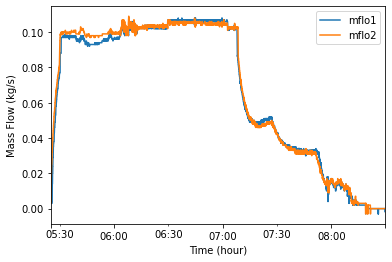

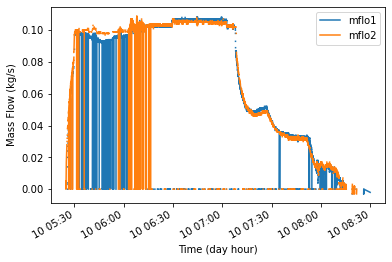

In [136]:
# example from segment
for segment in segments[test_segment:test_segment+1]:
    segment.fillna(method='ffill').plot(ylabel='Mass Flow (kg/s)', xlabel='Time (hour)');
    time_frame_1 = mflo1_unfiltered.index.tz_localize('Asia/Singapore') >= segment.index[0]
    time_frame_1 &= mflo1_unfiltered.index.tz_localize('Asia/Singapore') <= segment.index[-1]
    unfiltered_1 = mflo1_unfiltered.loc[time_frame_1]
    time_frame_2 = mflo2_unfiltered.index.tz_localize('Asia/Singapore') >= segment.index[0]
    time_frame_2 &= mflo2_unfiltered.index.tz_localize('Asia/Singapore') <= segment.index[-1]
    unfiltered_2 = mflo2_unfiltered.loc[time_frame_2]
    unfiltered = unfiltered_1.join(unfiltered_2, how='outer')
    # plt.plot(unfiltered['mflo1'], linewidth=1)
    # plt.plot(unfiltered['mflo2'], linewidth=1)
    # plt.show();
    unfiltered.plot(ylabel='Mass Flow (kg/s)', xlabel='Time (day hour)');
    pass

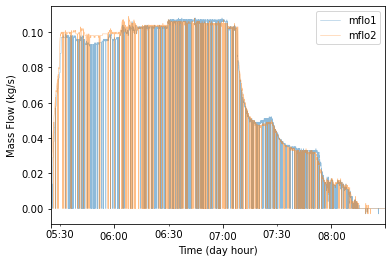

In [137]:
unfiltered.resample('1S').min().fillna(method='ffill').plot(ylabel='Mass Flow (kg/s)', xlabel='Time (day hour)', linewidth=0.5, alpha=0.5);

In [138]:
# Location Data (Latitude & Longitude)

In [139]:
# original location data is sparse, once in few minutes
# resampling (interpolation) to every second
# geodesic distance (in meter) is calculated between points (lat/lon)
# location data is segmented conforming bunker segments

In [140]:
# import swifter
# from geopy.distance import geodesic
# import tqdm._tqdm_notebook
# tqdm._tqdm_notebook.tqdm_notebook.pandas()

# location = pd.concat([pd.read_csv(f) for f in ['location1.csv', 'location2.csv']], ignore_index=True)
# location.columns = ['mmsi', 'status', 'speed', 'lon', 'lat', 'course', 'heading', 'ts']
# location.index = pd.to_datetime(location['ts'], format='%Y-%m-%d %H:%M:%S').dt.tz_localize('Asia/Singapore')
# location = location.loc[:, ('lon', 'lat')]
# location = location.resample('1S').interpolate(method='linear')
# location['_lon'] = location['lon'].shift(periods=-1)
# location['_lat'] = location['lat'].shift(periods=-1)
# location = location.drop(location.index[-1])
# location['distance'] = location.loc[:, ('_lat', '_lon', 'lat', 'lon')].progress_apply(lambda row: geodesic(row[:2], row[-2:]).meters, axis=1)

# with open('location.pkl', 'wb') as f:
#     pickle.dump(location, f)

# location

In [141]:
# interval: 1 second

segments_location = util.find_segments_location(segments, location_data, interval=1)

100%|██████████| 100/100 [04:13<00:00,  2.53s/it]


In [142]:
segments_location[test_segment]

# _lat & _lon are origin, lat & lon are destination

,_lat,_lon,lat,lon,distance
ts,,,,,
2020-05-10 05:24:50+08:00,1.27971,103.6682,1.279711,103.6682,0.002371
2020-05-10 05:24:51+08:00,1.27971,103.6682,1.279710,103.6682,0.002371
2020-05-10 05:24:52+08:00,1.27971,103.6682,1.279710,103.6682,0.002371
2020-05-10 05:24:53+08:00,1.27971,103.6682,1.279710,103.6682,0.002371
2020-05-10 05:24:54+08:00,1.27971,103.6682,1.279710,103.6682,0.002371
...,...,...,...,...,...
2020-05-10 08:29:48+08:00,1.28067,103.7502,1.280670,103.7502,0.000248
2020-05-10 08:29:49+08:00,1.28067,103.7502,1.280670,103.7502,0.000248
2020-05-10 08:29:50+08:00,1.28067,103.7502,1.280670,103.7502,0.000248


In [143]:
# loc = segments_location[test_segment]
# lat = loc['_lat'].tolist()[:1] + loc['lat'].tolist()
# lon = loc['_lon'].tolist()[:1] + loc['lon'].tolist()
# center_lat, center_lon = np.mean([min(lat), max(lat)]), np.mean([min(lon), max(lon)])
# span = (geodesic((max(lat), max(lon)), (min(lat), min(lon))).meters // 1000 + 2) * 1000

# for i, (s, clat, clon) in enumerate([(5E4, 1.3, 103.8), (span, center_lat, center_lon)]):
#     plt.figure(figsize=(10,10))
#     m = Basemap(projection='lcc', resolution='f',
#                 width=s, height=s, 
#                 lat_0=clat, lon_0=clon)
#     m.drawmapboundary(fill_color='white')
#     m.drawcoastlines()
#     x, y = m(lon, lat)
#     if i == 0:
#         m.plot(x, y, '.', markersize=0.5, linewidth=0.1, color='r') 
#     else:
#         m.plot(x, y, 'o-', markersize=1, linewidth=0.5, color='r')
#         m.plot(x[0], y[0], 'o-', markersize=10, color='k')
#     plt.show()

In [ ]:
# Wind and Direction Data

In [144]:
# parsing
# tm001 wind speed
# tm002 wind direction

In [145]:
%%time

param1 = util.parse_raw(folders, ['tm001'])
param1 = param1.loc[mask(param1)]

100%|██████████| 27252/27252 [03:06<00:00, 146.45it/s]
files not parsed:
sep2020\v1_200905_184918.pkl
sep2020\v1_200905_235501.pkl
sep2020\v1_200919_183258.pkl
Wall time: 4min 8s


In [146]:
%%time

param2 = util.parse_raw(folders, ['tm002'])
param2 = param2.loc[mask(param2)]

100%|██████████| 27252/27252 [01:46<00:00, 256.24it/s]
files not parsed:
sep2020\v1_200905_184918.pkl
sep2020\v1_200905_235501.pkl
sep2020\v1_200919_183258.pkl
Wall time: 2min 40s


In [180]:
%%time

# both wind data is resampled to every second frequency
# 10 bit raw reading (0 - 1023) representing 0 - 100 m/s (non-sustained) wind speed, and 
# 0 - 360 deg (clockwise from bow) wind direction
# wind effect is projected wind speed (m/s) along stern-bow axis, negative is sternward direction

wind = param1.join(param2)
wind = wind.dropna(thresh=1)
wind = wind.resample(resampling).mean().fillna(method='ffill')

wind['speed'] = wind['tm001'] / 1023 * 100
wind['direction'] = wind['tm002'] / 1023 * 360 % 360
wind = wind.drop(columns=['tm001', 'tm002'])
wind = wind.dropna(thresh=2)
# wind['timedelta'] = (wind.index - wind.index[0]).seconds
wind['effect'] = np.sin(np.deg2rad((wind['direction'] - 270) % 360)) * wind['speed']
wind.index = wind.index.tz_localize('Asia/Singapore')

Wall time: 4.53 s


In [169]:
# group wind data into segments, conforming bunker segments
# wind effect is offset by vessel movement (distance / second)

segments_wind = []
for segment, location in tqdm(zip(segments, segments_location), total=len(segments)):
    bgn, end = wind.index >= segment.index[0], wind.index <= segment.index[-1]
    locale = wind.loc[bgn & end]
    # offset wind from own movement
    locale['effect'] = locale['effect'] + location['distance']
    segments_wind.append(locale)

  0%|          | 0/100 [00:00<?, ?it/s]C:\Users\tzy\anaconda3\envs\efficientship\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

100%|██████████| 100/100 [00:13<00:00,  7.17it/s]


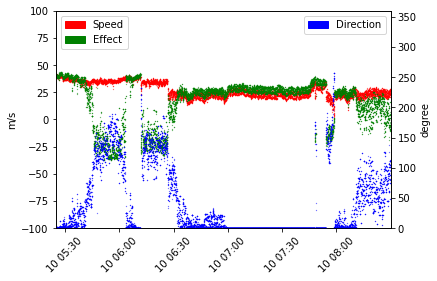

In [170]:
for ws in segments_wind[test_segment:test_segment+1]:
    fig = plt.figure()
    ax1 = fig.add_subplot(111)
    plt.xticks(rotation=45)
    plt.ylabel('m/s')
    plt.ylim((-100, 100))
    ax1.scatter(ws.index, ws['speed'], s=0.05, c='r')
    ax1.scatter(ws.index, ws['effect'], s=0.05, c='g')
    ax1.legend(handles=[mpatches.Patch(color='r', label='Speed'), mpatches.Patch(color='g', label='Effect')], loc='upper left')
    ax2 = ax1.twinx()
    plt.ylabel('degree')
    plt.ylim((0, 360))
    ax2.scatter(ws.index, ws['direction'], s=0.05, c='b')
    ax2.legend(handles=[mpatches.Patch(color='b', label='Direction')], loc='upper right')
    plt.xlim((ws.index[0], ws.index[-1]))
    plt.xlabel('Time (day hour)')
    plt.show();

In [171]:
wswd = segments_wind[test_segment].loc[:, ('speed', 'direction')]
wswd.columns = ['ws', 'wd']

WR = WindRose(wswd)
WR.plot(
    template='seaborn', colors='Plotly3', output_type='show', colors_reversed=False, 
    title='Wind Speed & Direction'
)

Wind speed and direction statistics have not been calculated, Calculating them now using default parameters.


In [172]:
# replace ws with mflow
wswd['ws'] = segments[test_segment].mean(axis=1)

WR = WindRose(wswd)
WR.plot(
    template='seaborn', colors='Plotly3', output_type='show', colors_reversed=False, 
    title='Fuel & Wind Direction'
)

Wind speed and direction statistics have not been calculated, Calculating them now using default parameters.


In [152]:
# indices

In [153]:
# check irregularities
idx_mflow = [segment.index.to_numpy() for segment in segments]
idx_wind = [segment.index.to_numpy() for segment in segments_wind]
idx_loc = [segment.index.to_numpy() for segment in segments_location]
is_irregular = True in list(map(lambda z: False in ((z[0] == z[1]) & (z[1] == z[2]) & (z[2] == z[0])), zip(idx_mflow, idx_wind, idx_loc)))
if is_irregular:
    print('segments NOT aligned')
else:
    print('segments are aligned')
    indices = idx_mflow

segments are aligned


In [157]:
is_aligned, temps = True, []
for i in range(len(indices)):
    mflow = segments[i].resample('5S').mean()
    wind = segments_wind[i].resample('5S').mean()
    speed = segments_location[i].resample('5S').mean()
    is_aligned &= np.all((mflow.index == wind.index) & (mflow.index == speed.index))
    if not is_aligned:
        print('segments not aligned after resampling')
        break
    temps.append((mflow, wind, speed))
else:
    for i, (mflow, wind, speed) in enumerate(temps):
        segments[i] = mflow
        segments_wind[i] = wind
        segments_location[i] = speed
    print('resampling done')

resampling done


In [158]:
# save checkpoint

with open('dataset_5s.pkl', 'wb') as f:
    pickle.dump({'index': indices, 'bunker': segments, 'wind': segments_wind, 'location': segments_location}, f)

In [45]:
# continue

In [46]:
import util
import pickle
import matplotlib.pyplot as plt

In [159]:
with open('dataset.pkl', 'rb') as f:
    ds = pickle.load(f)
indices, segments, segments_wind, segments_location = ds['index'], ds['bunker'], ds['wind'], ds['location']
len(indices)

100

In [160]:
# check irregularities
idx_mflow = [segment.index.to_numpy() for segment in segments]
idx_wind = [segment.index.to_numpy() for segment in segments_wind]
idx_loc = [segment.index.to_numpy() for segment in segments_location]
is_irregular = True in list(map(lambda z: False in ((z[0] == z[1]) & (z[1] == z[2]) & (z[2] == z[0])), zip(idx_mflow, idx_wind, idx_loc)))
if is_irregular:
    print('segments NOT aligned')
else:
    print('segments are aligned')

segments are aligned


In [161]:
%%time

n_class = 100

# signals: input (in array), scores: output, estimators: TimeSeriesKMeans estimator
# each has three elements (bunker, wind, distance)

signals, scores, estimators = util.get_scores(segments, segments_wind, segments_location, 
                                              stride=15, 
                                              time_constant=60, 
                                              n_cluster=n_class)

# save checkpoint
with open('scores.pkl', 'wb') as f:
    pickle.dump((signals, scores, estimators), f)

KeyboardInterrupt: 

In [50]:
# continue

In [51]:
import util
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans, DBSCAN, MiniBatchKMeans, AgglomerativeClustering, MeanShift
from concurrent.futures import ThreadPoolExecutor, ProcessPoolExecutor, as_completed
from sklearn.metrics import auc, mean_squared_error
from sklearn.preprocessing import normalize
from scipy.ndimage import gaussian_filter
from operator import itemgetter
from itertools import chain
from tqdm import tqdm

In [52]:
with open('scores.pkl', 'rb') as f:
    signals, scores, estimators = pickle.load(f)

n_class = 100

In [53]:
test_segment = 8

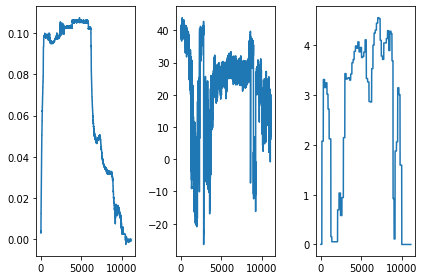

In [54]:
# signals[0] is signal's element 0: bunker
# example from segment #8
# x: time (n seconds), y: bunker in kg/m3

plt.subplot(1, 3, 1)
plt.plot(signals[0][test_segment])
plt.subplot(1, 3, 2)
plt.plot(signals[1][test_segment])
plt.subplot(1, 3, 3)
plt.plot(signals[2][test_segment])
plt.tight_layout()
plt.show();

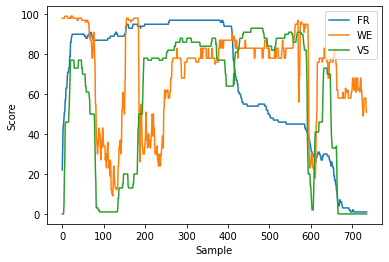

In [55]:
plt.plot(scores[0][test_segment], label='FR');
plt.plot(scores[1][test_segment], label='WE');
plt.plot(scores[2][test_segment], label='VS');
plt.ylabel('Score')
plt.xlabel('Sample')
plt.legend(loc='upper right')
plt.show();

# x: counts, period (time_constant: 60 seconds), stride: 15 seconds (overlap: 60-15 = 45 seconds)
# y: bunker score (maximum is equal to n_class)

In [56]:
# test segment is not exclude from HMM (hidden markov model) training
# test segment is not included in dataset either, will be later for test
# apply bias, assign epsilon

In [57]:
%%time

# bias is for stretching/squeezing a particular axial space 
# to purposefully make points closer or away
# lower is closer
biases = [1, 1, 1]
# epsilon is minimum distance of outermost cluster point to the next unclustered point 
# to absorb as cluster member
epsilon = np.sqrt(8)

# create datapoints, and apply bias
b = np.array([score for enum, score in enumerate(scores[0]) if enum != test_segment])
b = np.concatenate(b * biases[0])
w = np.array([score for enum, score in enumerate(scores[1]) if enum != test_segment])
w = np.concatenate(w * biases[1])
d = np.array([score for enum, score in enumerate(scores[2]) if enum != test_segment])
d = np.concatenate(d * biases[2])
datapoints = np.array([b, w, d]).T

Wall time: 2.99 ms
<timed exec>:10: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

<timed exec>:12: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

<timed exec>:14: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



In [58]:
# new

In [90]:
n_cluster = 300
infinite_breaker = 1000
cluster_quality_thresh = 1
centers = None

In [56]:
with open('centers_100.pkl', 'rb') as f:
    centers = pickle.load(f)
n_cluster = centers.shape[0]
centers.shape

(100, 3)

In [91]:
%%time

# k-means
n_cluster_ = n_cluster
cluster_centers = []
while True:
    if n_cluster_ > infinite_breaker:
        print('optimum not found')
        break
    # create clusters, without noise points
    if centers is not None:
        est = KMeans(n_clusters=n_cluster_, 
                    #  n_jobs=-1, 
                     init=centers)
    else:
        est = KMeans(n_clusters=n_cluster_, 
                    #  n_jobs=-1, 
                     )
    est.fit(datapoints)

    # inverse mean square error
    dfunc = lambda i: np.linalg.norm(datapoints[est.labels_==i] - est.cluster_centers_[i], axis=1)
    cluster_quality = np.array([dfunc(j) for j in range(n_cluster_)])
    cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])
    # cluster labels accepted
    accepted = cluster_quality >= cluster_quality_thresh
    print(f"n_cluster: {n_cluster_}, minimum: {np.min(cluster_quality)}")
    # accept or exit
    if not np.all(accepted) and centers is None:
        n_cluster_ += 5
    else:
        break

# mean shift
# est = MeanShift(bandwidth=9, 
#                 # cluster_all=False, 
#                 n_jobs=-1).fit(datapoints)

print('\nnumber of clusters:', est.cluster_centers_.shape[0], '\n')
n_cluster = est.cluster_centers_.shape[0]

<timed exec>:21: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

n_cluster: 300, minimum: 0.991195806423586
<timed exec>:21: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

n_cluster: 305, minimum: 0.778759116062594
<timed exec>:21: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

n_cluster: 310, minimum: 0.9065267343092451
n_cluster: 315, mi

number of member of five smallest clusters: 25 42 46 46 51 

largest: 175, 1918 counts
smallest: 306, 25 counts


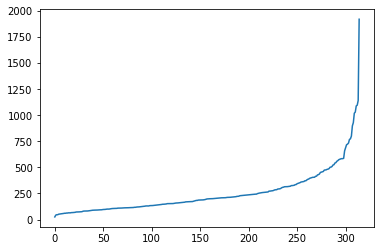

In [92]:
# number of members from each cluster, sorted from low to high
sorted_members = np.array(sorted([est.labels_[est.labels_==i].shape[0] for i in range(np.unique(est.labels_).shape[0])]))
print('number of member of five smallest clusters:', *sorted_members[:5], '\n')
unq, cts = np.unique(est.labels_, return_counts=True)
print('largest:', f"{np.where(cts==sorted_members[-1])[0][0]}, {sorted_members[-1]} counts")
print('smallest:', f"{np.where(cts==sorted_members[0])[0][0]}, {sorted_members[0]} counts")
plt.plot(sorted_members);

<ipython-input-93-2b25f5ba32fa>:5: MatplotlibDeprecationWarning:

Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.

<ipython-input-93-2b25f5ba32fa>:11: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



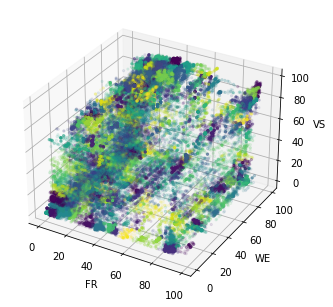

In [93]:
# datapoint_labels = util.associate_to_cluster(datapoints, est.cluster_centers_)
datapoint_labels = est.labels_

fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(datapoints[:, 0], datapoints[:, 1], datapoints[:, 2], 
           c=datapoint_labels.astype(float), alpha=0.1, marker='.')
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
fig.show()

<ipython-input-94-7dbeebc02df9>:6: MatplotlibDeprecationWarning:

Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.

<ipython-input-94-7dbeebc02df9>:14: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



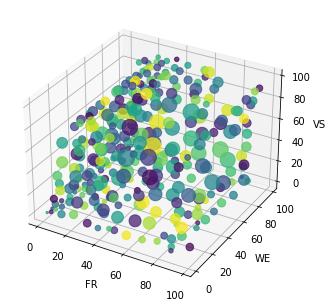

In [94]:
# inverse mean square error
cluster_quality = [np.linalg.norm(datapoints[datapoint_labels==i] - est.cluster_centers_[i], axis=1) for i in range(n_cluster)]
cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])

fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(est.cluster_centers_[:, 0], est.cluster_centers_[:, 1], est.cluster_centers_[:, 2], 
           c=np.unique(datapoint_labels).astype(float), alpha=0.75, marker='o', 
           s=n_cluster/cluster_quality/np.min(cluster_quality))
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
# ax.view_init(elev=30, azim=45)
fig.show()

In [95]:
print('lowest quality:', cluster_quality.min())
print('median quality:', np.median(cluster_quality))
print('highest quality:', cluster_quality.max())

lowest quality: 1.0253297460463286
median quality: 4.1410906502980165
highest quality: 70.3122717529267


In [96]:
plot_segment = test_segment

<ipython-input-97-8b7f959a75b9>:12: MatplotlibDeprecationWarning:

Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.

<ipython-input-97-8b7f959a75b9>:32: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



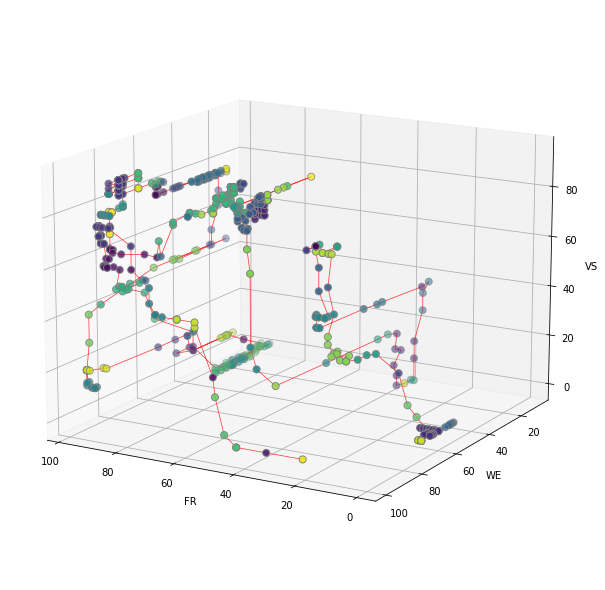

In [97]:
%matplotlib inline

# for plot_segment in [16, 48, 260, 257, 281, 306, 307, 312, 330, 366, 383, 392, 429, 435]:

# paint test_segment in cluster label color
ts = np.array([scores[0][plot_segment], scores[1][plot_segment], scores[2][plot_segment]]).T
pred = est.predict(ts)
reassign = dict(zip(set(pred), range(len(set(pred)))))

fig = plt.figure(figsize=(8,8))
fig.size = 12, 12
ax = Axes3D(fig)

bgn, end = 0, ts.shape[0]
# bgn, end = 340, 355
end += 1
ax.scatter(scores[0][plot_segment][bgn:end], scores[1][plot_segment][bgn:end], scores[2][plot_segment][bgn:end],
           c=[reassign[lab] for lab in pred][bgn:end], edgecolor='grey', s=50)
ax.plot(scores[0][plot_segment][bgn:end], scores[1][plot_segment][bgn:end], scores[2][plot_segment][bgn:end], 
        c='r', alpha=0.75, linewidth=0.75)

ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
# ax.set_xlim(0, n_class)
# ax.set_ylim(0, n_class)
# ax.set_zlim(0, n_class)

# ax.set_title(f"Segment #{plot_segment}")
ax.view_init(azim=120, elev=15)

fig.show()

In [67]:
pd.DataFrame(np.column_stack((pred, ts)), columns=['CN', 'FR', 'WE', 'VS'])[bgn:end].T

,0,1,2,3,4,5,6,7,8,9,...,726,727,728,729,730,731,732,733,734,735
CN,71,71,71,71,42,42,15,15,15,15,...,17,17,17,32,32,32,32,32,17,17
FR,22,34,44,44,48,51,51,57,57,63,...,1,1,1,1,1,1,1,1,1,1
WE,98,98,98,98,98,98,99,99,99,99,...,50,49,52,58,58,58,58,58,51,51
VS,0,0,0,0,4,18,26,44,46,46,...,0,0,0,0,0,0,0,0,0,0


In [68]:
%matplotlib inline

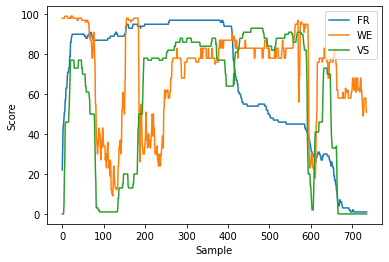

In [69]:
plt.plot(scores[0][test_segment], label='FR');
plt.plot(scores[1][test_segment], label='WE');
plt.plot(scores[2][test_segment], label='VS');
plt.ylabel('Score')
plt.xlabel('Sample')
plt.legend(loc='upper right')
plt.show();

In [70]:
cluster_num = 18

seg = np.array((scores[0][0], scores[1][0], scores[2][0])).T
# print('seg\n', seg)
cluster_member = est.labels_[0:seg.shape[0]]
print(cluster_member)
sequence = np.where(cluster_member == cluster_num)[0]
print(sequence)
dataset = {i: [] for i in range(n_cluster)}

wrong = []
ptr = sequence[0]
for idx in sequence[1:]:
    if idx - ptr != 1:
        # not adjacent
        i_member = seg[ptr:idx]
        if i_member.shape[0] > 1:
            # len is 2 or more
            wrong.append(i_member)
            # dataset[cluster_num].append(i_member)
        ptr = idx

cuts = [0] + list(np.where(np.diff(sequence) != 1)[0] + 1) + [sequence.shape[0]]
for p0, p1 in zip(cuts[:-1], cuts[1:]):
    p0, p1 = sequence[p0:p1][0], sequence[p0:p1][-1]+1
    member = seg[p0:p1]
    dataset[cluster_num].append(member)
    # disregard non-sequential datapoints
    # if member.shape[0] >= 2:
    #     member = list(np.column_stack((member[:-1:2,:].reshape((-1, 1, 3)), 
    #                                    member[1::2,:].reshape((-1, 1, 3)))))
    #     dataset[cluster_num].append(member)

dataset[cluster_num]

[ 9  9  9  9 80 80  9  9  9  9  9  9  9  9  9  9 80 80 80 37 17 97 54  5
  5 54 54 54  5  5  5 85 85 85 85  5  5  5 85 85 85 85 85  5  5  5  5  5
 54 54 43 43 82 82 82 82 82 82 82 52 52 52 52 52 52 52 52 52 52 52 52 52
 52 14 14 14 14 14 14 14 14 14 14 14 14 62 62 62 26 26 26 26 26 26 26 62
 62 62 62 62 62 62  3  3 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44
 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 44 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 42 42 42 42 42 42 42 42 42 42 42 42 42 42 71 71 71 71 71 71
 71 71 71 71 71 71 71 71 80 80 80 80 80 80 80 80  9  9  9  9  9]
[]


IndexError: index 0 is out of bounds for axis 0 with size 0

In [98]:
# prepare for training
dataset = {i: [] for i in range(n_cluster)}
bgn = 0
for enum, score in enumerate(zip(*scores)):
    if enum == test_segment:
        continue

    # segment points
    seg = np.array(score).T
    # find end then slice
    end = bgn + seg.shape[0]
    cluster_member = est.labels_[bgn:end]
    # for every cluster
    for i in range(n_cluster):
        # get index 
        sequence = np.where(cluster_member == i)[0]
        # must be 2 or more
        if sequence.shape[0] < 2:
            continue
        
        # wrong but works
        # ptr = sequence[0]
        # for idx in sequence[1:]:
        #     if idx - ptr != 1:
        #         # not adjacent
        #         i_member = seg[ptr:idx]
        #         if i_member.shape[0] > 1:
        #             # len is 2 or more
        #             dataset[i].append(i_member)
        #         ptr = idx

        cuts = [0] + list(np.where(np.diff(sequence) != 1)[0] + 1) + [sequence.shape[0]]
        for p0, p1 in zip(cuts[:-1], cuts[1:]):
            p0, p1 = sequence[p0:p1][0], sequence[p0:p1][-1]+1
            member = seg[p0:p1]
            dataset[i].append(member)
            # disregard non-sequential datapoints, useful for transition matrix only
            # if member.shape[0] >= 2:
            #     member = list(np.column_stack((member[:-1:2,:].reshape((-1, 1, 3)), 
            #                                    member[1::2,:].reshape((-1, 1, 3)))))
            #     dataset[i].append(member)
    bgn = end

for k, v in dataset.items():
    if len(v) == 0:
        print(k, 'has no member')

<ipython-input-72-8dab2cbe62b4>:25: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



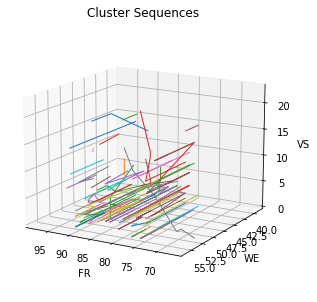

In [72]:
%matplotlib inline

traces = dataset[41]

fig, ax = plt.subplots(subplot_kw={'projection': '3d'}, figsize=(5,5))

for clr, trace in enumerate(traces):
    # ax.scatter(trace[:,0], trace[:,1], trace[:,2])
    ax.plot(trace[:,0], trace[:,1], trace[:,2], 
            # c='r', 
            alpha=1, linewidth=1)

# ax.set_xlim3d([0, 100])
# ax.set_ylim3d([0, 100])
# ax.set_zlim3d([0, 100])
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(30, 105)

ax.set_title(f"Cluster Sequences")
ax.view_init(azim=120, elev=15)

fig.show()

In [73]:
a, b = 40, 60
np.where((est.cluster_centers_[:,0] > a) & (est.cluster_centers_[:,0] < b))[0]

array([15, 19, 27, 31, 36, 42, 51, 59, 70, 73, 82, 87, 96], dtype=int64)

In [74]:
np.where(np.linalg.norm(est.cluster_centers_[76] - est.cluster_centers_, axis=1) < 20)[0]

array([64, 76], dtype=int64)

<ipython-input-75-8742b0025cc9>:25: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



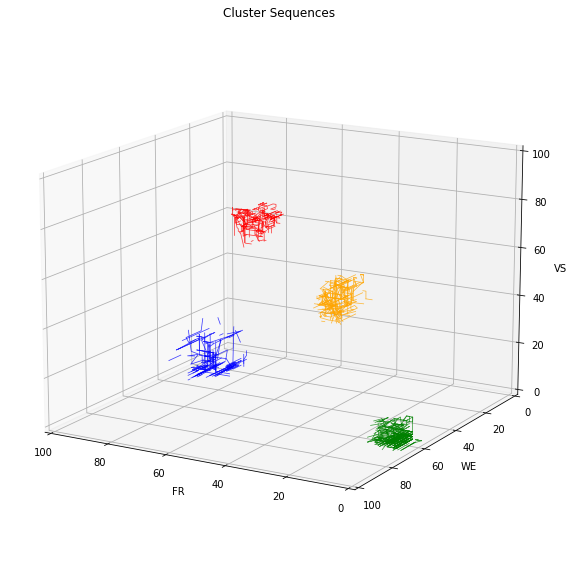

In [75]:
%matplotlib inline

traces_ = [dataset[i] for i in [1, 32, 76, 78]]
colors = ['r', 'g', 'b', 'orange']

fig, ax = plt.subplots(subplot_kw={'projection': '3d'}, figsize=(10,10))

for clr, traces in enumerate(traces_):
    for trace in traces:
        # ax.scatter(trace[:,0], trace[:,1], trace[:,2])
        ax.plot(trace[:,0], trace[:,1], trace[:,2], 
                alpha=0.75, linewidth=0.75, c=colors[clr])

ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')

ax.set_xlim(0, n_class)
ax.set_ylim(0, n_class)
ax.set_zlim(0, n_class)

ax.set_title(f"Cluster Sequences")
ax.view_init(azim=120, elev=15)

fig.show()

In [76]:
seqs = [(94, 94, 2), 
        (94, 95, 1), 
        # (95, 84, 5), 
        (95, 95, 5)]
mtx = np.zeros((100, 100))
for r, c, v in seqs:
    mtx[r, c] = v
for r, v in [(94, 3), (95, 5)]:
    mtx[r] /= v
pd.DataFrame(mtx, columns=np.arange(100)).iloc[92:97,92:97]

,92,93,94,95,96
92,0.0,0.0,0.000000,0.000000,0.0
93,0.0,0.0,0.000000,0.000000,0.0
94,0.0,0.0,0.666667,0.333333,0.0
95,0.0,0.0,0.000000,1.000000,0.0
96,0.0,0.0,0.000000,0.000000,0.0


In [77]:
mtx = np.zeros((100, ))
mtx[94] = 1
pd.DataFrame(mtx)[92:97].T

,92,93,94,95,96
0,0.0,0.0,1.0,0.0,0.0


<ipython-input-78-48bbcfa7389d>:8: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

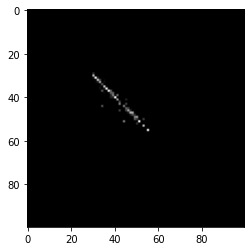

In [78]:
param = 0
param_hid, param_obs = 0, 2
segments = dataset[cluster_num]

try:
    segments = np.array([seg[:,param] for segment in segments for seg in segment])
except IndexError:
    segments = np.array([segment[:,param] for segment in segments])
    pairs = []
    for segment in segments:
        if segment.shape[0] < 2:
            continue
        pairs.extend(list(np.column_stack((segment[:-1:2], segment[1::2]))))
    segments = np.array(pairs)
assoc, cts = np.unique(segments, axis=0, return_counts=True)
mtx = np.zeros((n_class, n_class))
for (r, c), p in zip(assoc, cts): mtx[r,c] = p
div = np.tile(np.sum(mtx, axis=1), (mtx.shape[1], 1)).T
div[div==0] = 1
mtx /= div
# for rc in np.where(np.sum(mtx, axis=1) == 0)[0]: mtx[rc,rc] = 1

plt.imshow(mtx.T*255, cmap='gray');
mtx

In [79]:
mtx.shape

(100, 100)

In [99]:
%%time

# 0 bunker, 1 wind effect, 2 distance
hidden_param = 0
observable_param = 1
# hidden: to be predicted
# observable: input

# hmm = {}
# for i in tqdm(range(n_cluster), total=n_cluster):
#     pi = util.generate_initial_proba([seg[:, hidden_param] for seg in dataset[i]], n_class)
#     hidden = util.generate_hidden_matrix([seg[:, hidden_param] for seg in dataset[i]], n_class)
#     _, observable = util.generate_observable_matrix([seg[:, hidden_param] for seg in dataset[i]], 
#                                                     [seg[:, observable_param] for seg in dataset[i]], 
#                                                     n_class, i)
#     # hmm[i] = pi, hidden, gaussian_filter(observable, sigma=0.5)
#     hmm[i] = pi, hidden, observable

hmm1 = {}
pi, hidden, observable = [], [], []
with ThreadPoolExecutor() as executor:
    wait_for_1, wait_for_2, wait_for_3 = [], [], []
    for i in range(n_cluster):
        wait_for_1.append(executor.submit(util.generate_initial_proba, dataset[i], hidden_param, n_class, i))
        wait_for_2.append(executor.submit(util.generate_hidden_matrix, dataset[i], hidden_param, n_class, i))
        wait_for_3.append(executor.submit(util.generate_observable_matrix, dataset[i], hidden_param, observable_param, n_class, i))
    for f in tqdm(as_completed(wait_for_1), total=len(wait_for_1)):
        pi.append(f.result())
    for f in as_completed(wait_for_2):
        hidden.append(f.result())
    for f in as_completed(wait_for_3):
        observable.append(f.result())
pi = list(map(itemgetter(1), sorted(pi, key=itemgetter(0))))
hidden = list(map(itemgetter(1), sorted(hidden, key=itemgetter(0))))
observable = list(map(itemgetter(1), sorted(observable, key=itemgetter(0))))
for i, zipped in enumerate(zip(pi, hidden, observable)):
    hmm1[i] = zipped

c:\Users\tzy\Documents\ship\vscode\Github\util.py:250: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray

100%|██████████| 315/315 [00:00<00:00, 736.49it/s]Wall time: 476 ms



In [100]:
%%time

# 0 bunker, 1 wind effect, 2 distance
hidden_param = 0
observable_param = 2
# hidden: to be predicted
# observable: input

# hmm = {}
# for i in tqdm(range(n_cluster), total=n_cluster):
#     pi = util.generate_initial_proba([seg[:, hidden_param] for seg in dataset[i]], n_class)
#     hidden = util.generate_hidden_matrix([seg[:, hidden_param] for seg in dataset[i]], n_class)
#     _, observable = util.generate_observable_matrix([seg[:, hidden_param] for seg in dataset[i]], 
#                                                     [seg[:, observable_param] for seg in dataset[i]], 
#                                                     n_class, i)
#     # hmm[i] = pi, hidden, gaussian_filter(observable, sigma=0.5)
#     hmm[i] = pi, hidden, observable

hmm2 = {}
pi, hidden, observable = [], [], []
with ThreadPoolExecutor() as executor:
    wait_for_1, wait_for_2, wait_for_3 = [], [], []
    for i in range(n_cluster):
        wait_for_1.append(executor.submit(util.generate_initial_proba, dataset[i], hidden_param, n_class, i))
        wait_for_2.append(executor.submit(util.generate_hidden_matrix, dataset[i], hidden_param, n_class, i))
        wait_for_3.append(executor.submit(util.generate_observable_matrix, dataset[i], hidden_param, observable_param, n_class, i))
    for f in tqdm(as_completed(wait_for_1), total=len(wait_for_1)):
        pi.append(f.result())
    for f in as_completed(wait_for_2):
        hidden.append(f.result())
    for f in as_completed(wait_for_3):
        observable.append(f.result())
pi = list(map(itemgetter(1), sorted(pi, key=itemgetter(0))))
hidden = list(map(itemgetter(1), sorted(hidden, key=itemgetter(0))))
observable = list(map(itemgetter(1), sorted(observable, key=itemgetter(0))))
for i, zipped in enumerate(zip(pi, hidden, observable)):
    hmm2[i] = zipped

100%|██████████| 315/315 [00:00<00:00, 737.95it/s]Wall time: 481 ms



In [101]:
# prediction
sigma = 3

In [102]:
# some var names are recycled

def smoothen(inp, sig=1):
    to_blur = gaussian_filter(inp.copy(), sigma=sig)
    if len(to_blur.shape) > 1:
        div = np.sum(to_blur, axis=1)
        div[div==0] = 1
        div = np.tile(div, (to_blur.shape[1], 1)).T
    else:
        div = np.sum(to_blur)
    to_blur /= div
    return to_blur

score = np.array([scores[i][test_segment] for i in range(3)])
# cluster_member = util.get_cluster_member(score, est.cluster_centers_)
cluster_member = est.predict(score.T)

level = cluster_member[0]
cluster_member_segments, one_level = [], [level]
for i in range(1, cluster_member.shape[0]):
    if cluster_member[i] == level:
        one_level.append(cluster_member[i])
    else:
        cluster_member_segments.append(one_level)
        level = cluster_member[i]
        one_level = [level]
if len(one_level) > 0:
    cluster_member_segments.append(one_level)

path1, bgn = [], 0
for one_level in cluster_member_segments:
    end = bgn + len(one_level)
    pi, hidden, observable = hmm1[one_level[0]]
    pi = smoothen(pi, sig=sigma)
    hidden = smoothen(hidden, sig=sigma)
    observable = smoothen(observable, sig=sigma)
    p, *_ = util.viterbi(pi, hidden, observable, scores[2][test_segment][bgn:end])
    path1.extend(p)
    bgn = end

path2, bgn = [], 0
for one_level in cluster_member_segments:
    end = bgn + len(one_level)
    pi, hidden, observable = hmm2[one_level[0]]
    pi = smoothen(pi, sig=sigma)
    hidden = smoothen(hidden, sig=sigma)
    observable = smoothen(observable, sig=sigma)
    p, *_ = util.viterbi(pi, hidden, observable, scores[2][test_segment][bgn:end])
    path2.extend(p)
    bgn = end

In [103]:
import matplotlib.pyplot as plt

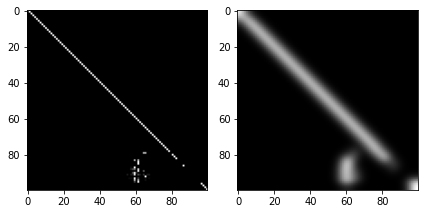

In [104]:
# 0:pi
# 1:hidden
# 2:observable

which_matrix = 2
for one_level in cluster_member_segments[7:8]:
    matrix1 = hmm2[one_level[0]][which_matrix]
    plt.subplot(1, 2, 1)
    plt.imshow(255*normalize(matrix1), cmap='gray')
    matrix2 = gaussian_filter(matrix1, sigma=sigma)
    div = np.sum(matrix2, axis=1)
    div[div==0] = 1
    matrix2 = matrix2 / np.tile(div, (matrix2.shape[1], 1)).T
    plt.subplot(1, 2, 2)
    plt.imshow(255*normalize(matrix2), cmap='gray')
    plt.tight_layout()
    plt.show();

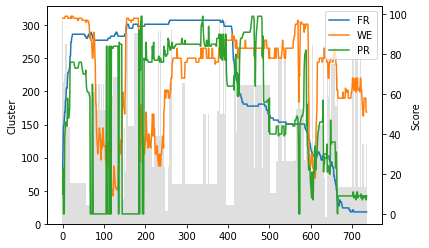


AUC (area under curve) difference from ground truth : -20.75 %
MSE (mean squared error) from ground truth          : 1295.15


In [105]:
hidden_param = 0
observable_param = 1

if True:
    plt.ylabel('Cluster')
    # plt.plot(cluster_member, color='k', linewidth=0.5)
    plt.bar(range(len(cluster_member)), cluster_member, width=1, facecolor='grey', alpha=0.25)
    plt.twinx()
    plt.ylabel('Score')
plt.plot(score[hidden_param], label='FR');
plt.plot(score[observable_param], label='WE');
plt.xlabel('Sample')
plt.plot(path1, label='PR');
plt.legend(loc='upper right');
plt.show();

auc_truth = auc(range(len(score[hidden_param])), score[hidden_param])
auc_pred = auc(range(len(path1)), path1)
auc_diff = (auc_pred - auc_truth) / auc_truth
print('\nAUC (area under curve) difference from ground truth : {:.2f} %'.format(100 * auc_diff))
print('MSE (mean squared error) from ground truth          : {:.2f}'.format(mean_squared_error(score[hidden_param], path1)))


AUC (area under curve) difference from ground truth : -2.57 %
MSE (mean squared error) from ground truth          : 183.88


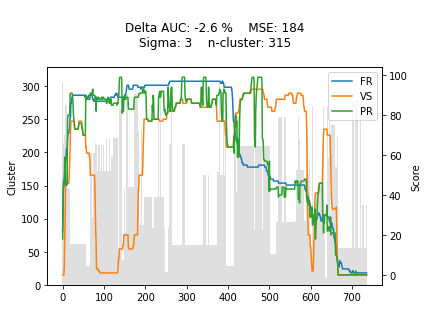

In [106]:
hidden_param = 0
observable_param = 2

if True:
    plt.ylabel('Cluster')
    # plt.plot(cluster_member, color='k', linewidth=0.5)
    plt.bar(range(len(cluster_member)), cluster_member, width=1, facecolor='grey', alpha=0.25)
    plt.twinx()
    plt.ylabel('Score')
plt.plot(score[hidden_param], label='FR');
plt.plot(score[observable_param], label='VS');
plt.plot(path2, label='PR');
plt.xlabel('Sample')
plt.legend(loc='upper right');

auc_truth = auc(range(len(score[hidden_param])), score[hidden_param])
auc_pred = auc(range(len(path2)), path2)
auc_diff = (auc_pred - auc_truth) / auc_truth

title_1 = '\nAUC (area under curve) difference from ground truth : {:.2f} %'.format(100 * auc_diff)
title_2 = 'MSE (mean squared error) from ground truth          : {:.2f}'.format(mean_squared_error(score[hidden_param], path2))
print(title_1)
print(title_2)

plt.title('\nDelta AUC: {:.1f} %'.format(100 * auc_diff) + 
          '    ' + 
          'MSE: {}'.format(round(mean_squared_error(score[hidden_param], path2))) + 
          '\n' +
          f'Sigma: {sigma}' +
          '    '  +
          f'n-cluster: {n_cluster}' +
          '\n')

plt.show();

In [88]:
sigma, n_cluster

(3, 100)

In [89]:
cluster_member[90]

41

In [36]:
from celluloid import Camera
from mpl_toolkits.mplot3d.axes3d import Axes3D
import matplotlib

font = {'family' : 'normal',
        # 'weight' : 'bold',
        'size'   : 12}

matplotlib.rc('font', **font)

In [41]:
%matplotlib ipympl

fig, axs = plt.subplots(1, 4, figsize=(20, 5))
# fig.tight_layout()
axs[0].set_title('Fuel Rate (FR) vs n-Sample')
axs[0].set_ylabel('FR Score')
axs[0].set_ylim((0, 100))
axs[1].set_title('Wind Effect (WE) vs n-Sample')
axs[1].set_xlabel('n-Sample')
axs[1].set_ylim((0, 100))
axs[2].set_title('Vessel Speed (VS) vs n-Sample')
axs[2].set_ylim((0, 100))
plt.xlim((0, score[0].shape[0]))

ax = fig.add_subplot(1, 4, 4, projection='3d')
ax.set_xlim3d([0, 100])
ax.set_xlabel('FR')
ax.set_ylim3d([0, 100])
ax.set_ylabel('WE')
ax.set_zlim3d([0, 100])
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(30, 105)

camera = Camera(fig)
for i in np.linspace(0, score[0].shape[0], 50):
    i = int(i)
    axs[0].plot(score[0,:i], c='r')
    axs[1].plot(score[1,:i], c='g')
    axs[2].plot(score[2,:i], c='b')
    ax.plot(score[0,:i], score[1,:i], score[2,:i], c='k', alpha=0.5, linewidth=1)
    ax.scatter(score[0,:i], score[1,:i], score[2,:i], c='k', s=25, alpha=0.25, edgecolor='white')
    camera.snap()
axs[3].axis('off')

animation = camera.animate()
# animation.save('segment_8.gif', writer='imagemagick')

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [42]:
animation.save('segment_8.gif', writer='imagemagick')

MovieWriter imagemagick unavailable; using Pillow instead.


In [37]:
%matplotlib ipympl

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
# plt.xlim((0, score[0].shape[0]))
# plt.ylim((0, 100))

camera = Camera(fig)
bgn = 0
subsets = []
for i in np.linspace(0, signals[0][test_segment].shape[0], 125)[1:]:
    end = int(i)
    subset = signals[0][test_segment][bgn:end]
    subsets.append(subset)
    axs[0].plot(np.arange(bgn, end), subset, c='r', linewidth=3)
    for s in subsets:
        axs[1].plot(s, c='k', alpha=0.25, linewidth=1)
    camera.snap()
    bgn = end
axs[0].plot(signals[0][test_segment], c='k', alpha=0.25, linewidth=1)
axs[0].set_title('Fuel Rate (FR) vs Time')
axs[0].set_xlabel('Time (s)')
axs[0].set_ylabel('FR (kg/s)')
axs[1].axis('off')
axs[1].axis('off')
axs[1].set_title('FR vs Time Delta | Cumulative')

animation = camera.animate()

for s in subsets:
    axs[2].plot(s, c='k', alpha=0.25, linewidth=1)
axs[2].set_title('FR vs Time Delta | Final')
axs[2].set_xlabel('Time Delta (s)')


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Text(0.5, 0, 'Time Delta (s)')

In [41]:
%matplotlib ipympl

fig, axs = plt.subplots(1, 1, figsize=(5, 5))

for s in subsets:
    axs.plot(s, c='k', alpha=0.25, linewidth=1)
axs.set_title('FR (kg/s) vs Time Delta')
axs.set_xlabel('Time Delta (s)')

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Text(0.5, 0, 'Time Delta (s)')

In [44]:
[prop for prop in dir(animation) if not prop.startswith('_')]

['event_source',
 'frame_seq',
 'new_frame_seq',
 'new_saved_frame_seq',
 'pause',
 'repeat',
 'resume',
 'save',
 'to_html5_video',
 'to_jshtml']

In [45]:
animation.pause()

In [46]:
animation.save('signal_subsets.gif', writer='imagemagick')

MovieWriter imagemagick unavailable; using Pillow instead.


In [43]:
cn = 44

seqs_0, seqs_1, seqs_2 = [], [], []
for trace in dataset[cn]:
    if trace[:,0].shape[0] < 2 or trace[:,1].shape[0] < 2:
        continue
    seq = list(zip(trace[:-1,0], trace[1:,0]))
    seqs_0.extend(seq)
    seq = list(zip(trace[:-1,1], trace[1:,1]))
    seqs_1.extend(seq)
    seq = list(zip(trace[:-1,2], trace[1:,2]))
    seqs_2.extend(seq)
print(len(seqs_0))

43


In [44]:
%matplotlib ipympl

fig, axs = plt.subplots(1, 5, figsize=(20, 5), gridspec_kw={'width_ratios': [5, 1, 1, 5, 5]})
fig.tight_layout()
axs[0].axis(False)
axs[0].set_title('Sequences in Score Space')
axs[1].axes.get_xaxis().set_ticklabels(['', 'A', 'B'])
axs[2].axes.get_xaxis().set_visible(False)
axs[2].axes.get_yaxis().set_visible(False)
axs[3].set_title('Transition')
axs[3].set_xlabel('FR-B')
axs[3].set_ylabel('FR-A')
axs[3].axes.get_xaxis().set_ticks([i for i in range(0, 50, 5)])
axs[3].axes.get_yaxis().set_ticks([i for i in range(0, 50, 5)])
axs[4].set_title('Emission')
axs[4].set_xlabel('FR')
axs[4].set_ylabel('VS')
axs[4].axes.get_xaxis().set_ticks([i for i in range(0, 50, 5)])
axs[4].axes.get_yaxis().set_ticks([i for i in range(0, 50, 5)])

ax = fig.add_subplot(1, 3, 1, projection='3d')
ax.set_xlim3d([0, 50])
ax.set_ylim3d([25, 75])
ax.set_zlim3d([0, 50])
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(15, 105)

grid_tr = np.zeros((50, 50))
grid_em = np.zeros((50, 50))

camera = Camera(fig)
ss = []
for seq_0, seq_1, seq_2 in tqdm(zip(seqs_0, seqs_1, seqs_2), total=len(seqs_0)):
    axs[1].plot(seq_0, c='k', alpha=0.25, linewidth=1)
    ss.append(seq_0)
    grid_tr[seq_0[1], seq_0[0]] = grid_tr[seq_0[1], seq_0[0]]  + 1
    grid_em[seq_2[0], seq_0[0]] = grid_em[seq_2[0], seq_0[0]]  + 1
    grid_em[seq_2[1], seq_0[1]] = grid_em[seq_2[1], seq_0[1]]  + 1
    for s in ss:
        axs[2].plot(s, c='k', alpha=0.25, linewidth=1)
    ax.plot(seq_0, seq_1, seq_2, c='r', linewidth=3)
    ax.scatter(seq_0, seq_1, seq_2, c='r', s=25)
    ax.text(seq_0[0], seq_1[0], seq_2[0], 'A', ha='right', va='top')
    ax.text(seq_0[1], seq_1[1], seq_2[1], 'B', ha='left', va='bottom')
    axs[3].imshow(grid_tr, cmap='gray')
    axs[4].imshow(grid_em, cmap='gray')
    camera.snap()

animation = camera.animate()

for trace in dataset[cn]:
    ax.plot(trace[:,0], trace[:,1], trace[:,2], c='k', alpha=0.25, linewidth=1)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

<ipython-input-44-e0445f61420d>:7: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs[1].axes.get_xaxis().set_ticklabels(['', 'A', 'B'])
  0%|          | 0/43 [00:00<?, ?it/s]


IndexError: index 63 is out of bounds for axis 0 with size 50

In [132]:
%matplotlib ipympl

from scipy.ndimage import gaussian_filter

fig, axs = plt.subplots(1, 2, figsize=(10, 5), gridspec_kw={'width_ratios': [1, 1]})
fig.tight_layout()

axs[0].set_title('Original')
axs[0].imshow(grid_em, cmap='gray')
axs[1].set_title('Filtered')
axs[1].imshow(gaussian_filter(grid_em, sigma=1), cmap='gray')

plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [124]:
animation.save('hmm_seq.gif', writer='imagemagick')

MovieWriter imagemagick unavailable; using Pillow instead.


In [125]:
%matplotlib ipympl

fig, axs = plt.subplots(1, 1, figsize=(5, 5))
# fig.tight_layout()
axs.axis(False)

ax = fig.add_subplot(1, 1, 1, projection='3d')
ax.set_xlim3d([0, 100])
ax.set_xlabel('FR')
ax.set_ylim3d([0, 100])
ax.set_ylabel('WE')
ax.set_zlim3d([0, 100])
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(30, 105)

camera = Camera(fig)
for i in np.linspace(0, score[0].shape[0], 50):
    i = int(i)
    ax.plot(score[0,:i], score[1,:i], score[2,:i], c='k', alpha=0.5, linewidth=1)
    ax.scatter(score[0,:i], score[1,:i], score[2,:i], c='k', s=25, alpha=0.25, edgecolor='white')
    camera.snap()

animation = camera.animate()
# animation.save('segment_8.gif', writer='imagemagick')

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [126]:
animation.save('3d_seq_only.gif', writer='imagemagick')

MovieWriter imagemagick unavailable; using Pillow instead.
